## Melbourne Housing Price Analysis

## Term Project 

## DSC630-T302

## Lincoln Brown and James Mulvihill

## Professor Hua

In [2]:
# Import the libraries
import folium
from folium import IFrame
from folium.plugins import MarkerCluster
import geopandas as gpd
import json
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import seaborn as sns
from scipy.stats import shapiro, skew, kurtosis, zscore
from shapely.geometry import shape
from shapely.geometry import Point
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb

## Functions

In [3]:
# Create a function to Label Encode dataset
# Input is a dataframe
# Output is the label encoded dataframe
def encode_labels(df):
    # Check for geometry column and drop it
    if 'geometry' in df.columns:
        df.drop(['geometry'],axis=1, inplace=True)
    # Create a LabelEncoder
    label_encoder = LabelEncoder()
    for col in df.columns:
        if df[col].dtype == 'object':
            df[col] = label_encoder.fit_transform(df[col])
    return df

In [4]:
# Create a function to run the random fores model on a dataset
# Input is a dataframe
# Output is a list of train test split data and the model built and trained
def run_random_forest(df):
    # Split the data into features (X) and target (y)
    X = df.drop(['Price'], axis=1)
    y = df['Price']
    
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Initialize model
    random_forest = RandomForestRegressor(random_state=42)
    
    
    # Fit models
    random_forest.fit(X_train, y_train)
    # Store the split dataset in a dict
    split_data = {"X_train": X_train, "X_test": X_test, "y_train": y_train, "y_test": y_test}
    # Store the models in a dict
    models = {"Random Forest": random_forest}
    # Return output as a list of dicts
    output = [split_data, models]
    return output

In [5]:
# Create a function to run the models on a dataset
# Input is a dataframe
# Output is a list of train test split data and the models built and trained. 
def run_models(df):
    # Split the data into features (X) and target (y)
    X = df.drop(['Price'], axis=1)
    y = df['Price']
    
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Initialize models
    linear_reg = LinearRegression()
    decision_tree = DecisionTreeRegressor(random_state=42)
    random_forest = RandomForestRegressor(random_state=42)
    #xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
                #max_depth = 5, alpha = 10, n_estimators = 100)
    
    
    # Fit models
    linear_reg.fit(X_train, y_train)
    decision_tree.fit(X_train, y_train)
    random_forest.fit(X_train, y_train)
    #xg_reg.fit(X_train, y_train)
    # Store the split dataset in a dict
    split_data = {"X_train": X_train, "X_test": X_test, "y_train": y_train, "y_test": y_test}
    # Store the models in a dict
    models = {"Linear Regression": linear_reg, "Decision Tree": decision_tree, "Random Forest": random_forest}
    # Return output as a list of dicts
    output = [split_data, models]
    return output

In [108]:
# Create a function to plot the residuals
# Input is a list of test train split data and a dict of models
def plot_residuals(input):
    # Get the models and test data from the output
    models = input[1]
    X_test = input[0]['X_test']
    y_test = input[0]['y_test']
    
    # Check if only one model is passed
    if len(models) == 1:
        # Only one model, do not include subplots
        name, model = next(iter(models.items()))
        # Make predictions
        y_pred = model.predict(X_test)
        # Calculate residuals
        residuals = y_test - y_pred
        # Plot residuals
        sns.residplot(x=y_pred, y=residuals, lowess=True, line_kws={'color': 'orange'})
        plt.title(f"Residuals for {name}")
        plt.xlabel("Fitted values")
        plt.ylabel("Residuals")
        plt.axhline(y=0, color='r', linestyle='--')
        plt.savefig('ResidualPlot.png')
    else:
        # Multiple models, include subplots
        num_models = len(models)
        num_rows = 2
        num_cols = 2
        fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols)
        axs = axs.flatten()
        
        # Iterate over models and plot residuals
        for i, (name, model) in enumerate(models.items()):
            # Make predictions
            y_pred = model.predict(X_test)
            # Calculate residuals
            residuals = y_test - y_pred
            # Plot residuals
            sns.residplot(x=y_pred, y=residuals, lowess=True, ax=axs[i], line_kws={'color': 'orange'})
            axs[i].set_title(f"Residuals for {name}")
            axs[i].set_xlabel("Fitted values")
            axs[i].set_ylabel("Residuals")
            axs[i].axhline(y=0, color='r', linestyle='--')

        for j in range(num_models, num_rows * num_cols):
            axs[j].axis('off')
        plt.tight_layout()
    plt.show()

In [7]:
# Create a function to get the evaluation metrics of the models
# Input is a list of test train split data and models
# Output is a dataframe of the evaluation metrics
def get_metrics(input):
    # Get the train test split data
    data = input[0]
    X_test = data['X_test']
    y_test = data['y_test']
    # Get the models
    models = input[1]
    model_metrics = {}
    scores_df = pd.DataFrame(columns=['Model', 'RMSE', 'MAE', 'R2'])
    for name, model in models.items():
        # Make predictions
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        scores_df.loc[len(scores_df)] = [name, rmse, mae, r2]
    return scores_df

In [8]:
# Create a function to get the feature importance/coefficients for the models passed
# Takes in a list of test train split data and a dict of models
# Returns a dataframe of feature importance
def get_feature_importance(input):
    # Get the train test split data
    data = input[0]
    X_train = data['X_train']
    # Get the models
    models = input[1]
    feature_importance_df = pd.DataFrame(columns=['Model', 'Feature1', 'Feature2', 'Feature3', 'Feature4', 'Feature5', 'Importance1', 'Importance2', 'Importance3', 'Importance4', 'Importance5'])
    # Iterate through the models and capture their 5 most important features and the feature importance
    for name, model in models.items():
        if isinstance(model, LinearRegression):
            # Feature importance is measured using coefficients in a LinearRegression
            coefficients = model.coef_
            sorted_indices = np.argsort(np.abs(coefficients))[::-1][:5]
            top_features = X_train.columns[sorted_indices]
            top_coefficients = coefficients[sorted_indices]
            feature_importance_df.loc[len(feature_importance_df)] = [name] + top_features.tolist() + [np.nan] * (5 - len(top_features)) + top_coefficients.tolist() + [np.nan] * (5 - len(top_coefficients))
        elif isinstance(model, DecisionTreeRegressor) or isinstance(model, RandomForestRegressor):
            importances = model.feature_importances_
            sorted_indices = np.argsort(importances)[::-1][:5]
            top_features = X_train.columns[sorted_indices]
            top_importances = importances[sorted_indices]
            feature_importance_df.loc[len(feature_importance_df)] = [name] + top_features.tolist() + [np.nan] * (5 - len(top_features)) + top_importances.tolist() + [np.nan] * (5 - len(top_importances))
    return feature_importance_df

In [9]:
# Create a function to check the skew and kurtosis of a feature
# Returns skew and kurtosis of passed data and feature
def get_skew_kurtosis(df, feature):
    skew = df[feature].skew()
    kurtosis = df[feature].kurtosis()
    # Print the results
    print(f"The skew of {feature} is: {skew}")
    print(f"The kurtosis of {feature} is: {kurtosis}")
        

In [10]:
# Create a function to look at the distribution of a feature
# Using a Histogram and Boxplot
# Displays visualizations
def visualize_distribution(df, feature):
    num_rows = 1
    num_cols = 2
    fig, axs = plt.subplots(num_rows, num_cols)
    sns.histplot(data=df[feature], ax=axs[0])
    axs[0].set_title(f"Histogram of {feature}")
    axs[0].set_xlabel('Price')
    axs[0].set_ylabel('Count')
    sns.boxplot(data=df[feature], ax=axs[1])
    axs[1].set_title(f"Boxplot of {feature}")
    axs[1].set_ylabel('Price')
    plt.tight_layout()
    plt.show()

## Data Import

In [97]:
# Import the dataset and verify it loaded correctly
housing_df = pd.read_csv("melb_data.csv")
print(f"There are {housing_df.shape[0]} records and {housing_df.shape[1]} columns before cleaning.")
housing_df.head()

There are 13580 records and 21 columns before cleaning.


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


## Data Cleaning

In [49]:
# We only want to focus on houses and townhouses
print(housing_df['Type'].unique())
housing_df = housing_df.loc[(housing_df['Type']=='h') | (housing_df['Type']=='t'),:]
print(f"After removing apartments (housing type 'u'), we have {housing_df.shape[0]} rows and {housing_df.shape[1]} columns.")

['h' 'u' 't']
After removing apartments (housing type 'u'), we have 10563 rows and 21 columns.


In [50]:
# Fix the misspelled columns
housing_df = housing_df.rename(columns={'Lattitude': 'Latitude','Longtitude': 'Longitude'})

In [51]:
# Get the range of dates
print(housing_df['Date'].tail(1))
print("We can see that the date range is in the format 'DD/MM/YY'")
print(f"The date range is: {housing_df['Date'].min()}-{housing_df['Date'].max()}")

13579    26/08/2017
Name: Date, dtype: object
We can see that the date range is in the format 'DD/MM/YY'
The date range is: 1/07/2017-9/09/2017


In [52]:
# Now we will fix the data range and change it to the American standard format
# Create a new copy of the dataset to modify
housing_cleaned = housing_df.copy()
# Adjust the date column to American format MM/DD/YY
housing_cleaned.loc[:,'Date'] = pd.to_datetime(housing_cleaned.loc[:,'Date'], format="%d/%m/%Y")
# Print the date range
print(f" The date range is: {housing_cleaned['Date'].min()} - {housing_cleaned['Date'].max()}")

 The date range is: 2016-01-28 00:00:00 - 2017-09-23 00:00:00


### Remove Missing Values

In [53]:
# Let's check for missing values
housing_cleaned.isna().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                60
Landsize            0
BuildingArea     5017
YearBuilt        4393
CouncilArea      1314
Latitude            0
Longitude           0
Regionname          0
Propertycount       0
dtype: int64

In [54]:
# Now, we will drop columns that contain missing values
housing_dropped = housing_cleaned.copy()
housing_dropped = housing_dropped.dropna(axis=1)
housing_dropped.shape

(10563, 17)

In [55]:
# Create IsWaterfront feature
# Load the gdf
port_phillip_buffer = gpd.read_file("port_phillip_with_buffer.shp")

# Convert lat lon to Point geometries
housing_dropped.loc[:,'geometry'] = housing_dropped.copy().apply(lambda row: Point(row['Longitude'], row['Latitude']), axis=1)

# Initialize the IsWaterfront column
housing_dropped.loc[:,'IsWaterfront'] = 0

# Iterate through the property geometries and check if they intersect with the buffer
for index, property_row in housing_dropped.iterrows():
    property_geometry = property_row['geometry']

    # Check if property interesects with boundary feature
    for boundary_row in port_phillip_buffer.iterrows():
        boundary_geometry = boundary_row[1]['geometry']
        if property_geometry.intersects(boundary_geometry):
            housing_dropped.at[index, 'IsWaterfront'] = 1 # Set IsWaterfront to 1


## Melbourne Maps

### Boundary Map

In [88]:
# Read the shapefile into a GeoDataFrame
port_phillip_gdf = gpd.read_file("port_phillip_bay.shp")

# Set the CRS for the geodataframe
port_phillip_gdf.crs = "EPSG:4326"

# Create the Folium map centered around the first feature
port_phillip_bay_map = folium.Map(location=[port_phillip_gdf.iloc[0].geometry.centroid.y, port_phillip_gdf.iloc[0].geometry.centroid.x], zoom_start=10)

# Add the GeoDataFrame to the map
folium.GeoJson(port_phillip_gdf).add_to(port_phillip_bay_map)

# Create an empty list to hold buffered geometries
buffered_geometries = []

# Iterate through each feature in the GeoDataFrame
for idx, row in port_phillip_gdf.iterrows():
    # Create a boundary around the feature
    boundary = row['geometry'].buffer(0.002)
    
    # Convert boundary to Shapely geometry
    boundary_shape = shape(boundary.__geo_interface__)
    
    # Add the boundary geometry to the list
    buffered_geometries.append(boundary_shape)

    # Create a GeoJSON representation of the boundary
    boundary_feature = folium.GeoJson(boundary)
    
    # Add the boundary to the map with red color
    boundary_feature.add_to(port_phillip_bay_map)

# Convert the list of buffered geometries to a GeoDataFrame
buffered_gdf = gpd.GeoDataFrame(geometry=buffered_geometries, crs="EPSG:4326")

# Add the buffered geometries to the original GeoDataFrame
port_phillip_gdf_buffer = port_phillip_gdf.copy()
port_phillip_gdf_buffer = pd.concat([port_phillip_gdf_buffer, buffered_gdf])

# Create a marker cluster
marker_cluster = MarkerCluster(name="Melbourne Properties").add_to(port_phillip_bay_map)

# Add markers for each property
for index, row in housing_dropped_iqr.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Suburb']).add_to(marker_cluster)

# Save the gdf
port_phillip_gdf_buffer.to_file("port_phillip_with_buffer.shp")

# Save the map
port_phillip_bay_map.save("port_phillip_bay_map.html")

# Display the map
port_phillip_bay_map


### Region Map

In [96]:
# Create a Folium map centered on Melbourne
region_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=10)

# Define unique colors for each region
region_colors = {
    'Northern Metropolitan': 'red',
    'Southern Metropolitan': 'blue',
    'Eastern Metropolitan': 'green',
    'Western Metropolitan': 'purple',
    'South-Eastern Metropolitan': 'orange',
    'Eastern Victoria': 'yellow',
    'Northern Victoria': 'pink',
    'Western Victoria': 'brown'
}

# Add markers to the map
for idx, row in housing_dropped_iqr.iterrows():
    region = row['Regionname']
    color = region_colors.get(region, 'black')  # Default to black if region not in region_colors
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        popup=f"{row['Suburb']} - {region}",
        color=color,
        fill=True,
        fill_color=color
    ).add_to(region_map)

# Add legend
legend_html = '''
     <div style="position: fixed; bottom: 50px; left: 50px; width: 250px; height: 200px; 
     background-color: white; border-radius: 5px; z-index:9999; font-size:14px;
     ">
     &nbsp; Region Legend <br>
     &nbsp; Northern Metropolitan &nbsp; <i class="fa fa-circle" style="color:red"></i><br>
     &nbsp; Southern Metropolitan &nbsp; <i class="fa fa-circle" style="color:blue"></i><br>
     &nbsp; Eastern Metropolitan &nbsp; <i class="fa fa-circle" style="color:green"></i><br>
     &nbsp; Western Metropolitan &nbsp; <i class="fa fa-circle" style="color:purple"></i><br>
     &nbsp; South-Eastern Metropolitan &nbsp; <i class="fa fa-circle" style="color:orange"></i><br>
     &nbsp; Eastern Victoria &nbsp; <i class="fa fa-circle" style="color:yellow"></i><br>
     &nbsp; Northern Victoria &nbsp; <i class="fa fa-circle" style="color:pink"></i><br>
     &nbsp; Western Victoria &nbsp; <i class="fa fa-circle" style="color:brown"></i><br>
      </div>
     '''

region_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map in the notebook (if running in a Jupyter Notebook)
region_map

In [57]:
print(f"There are {housing_dropped.shape[0]} rows and {housing_dropped.shape[1]} columns after dropping missing values.")
housing_dropped.head()

There are 10563 rows and 19 columns after dropping missing values.


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Landsize,Latitude,Longitude,Regionname,Propertycount,geometry,IsWaterfront
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,2016-12-03 00:00:00,2.5,3067.0,2.0,1.0,202.0,-37.7996,144.9984,Northern Metropolitan,4019.0,POINT (144.9984 -37.7996),0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,2016-02-04 00:00:00,2.5,3067.0,2.0,1.0,156.0,-37.8079,144.9934,Northern Metropolitan,4019.0,POINT (144.9934 -37.8079),0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,2017-03-04 00:00:00,2.5,3067.0,3.0,2.0,134.0,-37.8093,144.9944,Northern Metropolitan,4019.0,POINT (144.9944 -37.8093),0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,2017-03-04 00:00:00,2.5,3067.0,3.0,2.0,94.0,-37.7969,144.9969,Northern Metropolitan,4019.0,POINT (144.9969 -37.7969),0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,2016-06-04 00:00:00,2.5,3067.0,3.0,1.0,120.0,-37.8072,144.9941,Northern Metropolitan,4019.0,POINT (144.9941 -37.8072),0


## Data Exploration

We will being our data exploration by looking at the distribution of Price and checking its skew and kurtosis.

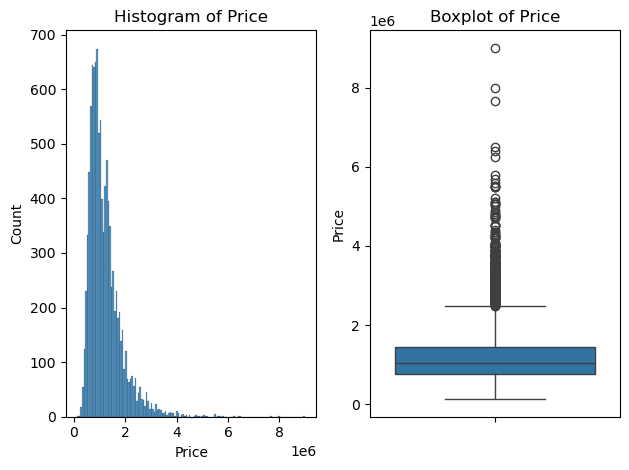

In [58]:
visualize_distribution(housing_dropped, 'Price')

### Price Distribution Analysis

From the histogram above, we can see that the dataset has positive skew, which means that there are outliers on the right tail of the dataset. We can see the evidence of these outliers more clearly in the boxplot on the right. The circles indicate outliers from the dataset, the blue box represents the interquartile range. 

In [59]:
get_skew_kurtosis(housing_dropped, 'Price')

The skew of Price is: 2.2534340892543265
The kurtosis of Price is: 10.006420101774543


### Boxplot Analysis

From the graph above we can see that there are a lot of outliers in the higher priced houses. We will look at two different methods to handle these outliers, zscore and Inter-Quartile Range (IQR). 

For z-scores we will look for any data points that lie outside of three standard deviations from the mean. 

Using interquartile range, we will isolate any data points that lie outside of the 25th and 75th percentiles. 


## Dataset Creation

### Z-score Dataset

In [60]:
# Calculate the zscore
zscores = zscore(housing_dropped['Price'])

# Set the threshold for 3 standard deviations
threshold = 3 

housing_dropped_zscore = housing_dropped.copy()
housing_dropped_zscore = housing_dropped_zscore.loc[np.abs(zscores) < threshold].copy()
print(f"There are {housing_dropped_zscore.shape[0]} rows and {housing_dropped_zscore.shape[1]} columns.")

There are 10380 rows and 19 columns.


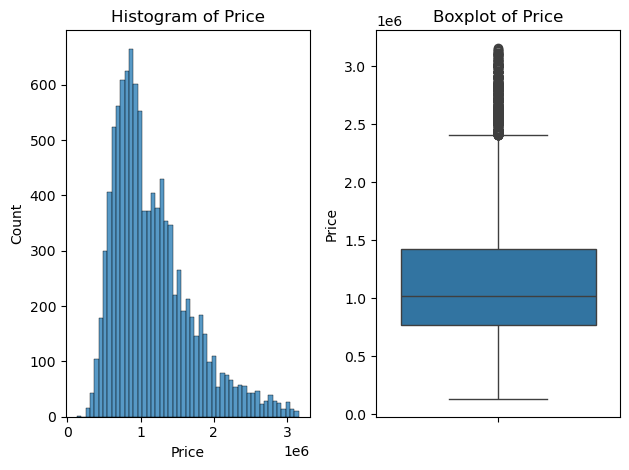

In [61]:
# Examine the distribution of price after dropping outliers using the zscore method
visualize_distribution(housing_dropped_zscore, 'Price')

In [62]:
# Get the skew and kurtosis of the price distribution for the zscore df
get_skew_kurtosis(housing_dropped_zscore, 'Price')

The skew of Price is: 1.112699026633222
The kurtosis of Price is: 1.074573064350826


### Zscore Price Distribution Analysis

From the histogram on the left, we can see that there is still a heavy tail on the right hand side of the graph. This is further evidenced by the boxplot on the right, illustrating that there are still a substantial number of outliers in the dataset after removing outliers using the zscore. 

Additionally, the skew and kurtosis of the distribution have improved from the original dataset. Although the scores are improved, they are still not great. 

### IQR Dataset

In [98]:
# Copy the housing dropped dataset
housing_dropped_iqr = housing_dropped.copy()
# Remove the outliers from Price using InterQuartile Range(IQR)
# Calculate the first quantile
Q1 = housing_dropped_iqr['Price'].quantile(0.25)
# Calculate the third quantile
Q3 = housing_dropped_iqr['Price'].quantile(0.75)

# Calculate the interquartile range
IQR = Q3 - Q1

# Define the threshold for outliers
threshold = 1.5

# Define the upper and lower bounds
lower_bound = Q1 - threshold * IQR
upper_bound = Q3 + threshold * IQR

# Remove outliers
housing_dropped_iqr = housing_dropped_iqr.loc[(housing_dropped_iqr['Price'] >= lower_bound) & (housing_dropped_iqr['Price'] <= upper_bound), :]
print(f"There are {housing_dropped_iqr.shape[0]} records and {housing_dropped_iqr.shape[1]} columns after dropping outliers in Price.")

There are 10062 records and 19 columns after dropping outliers in Price.


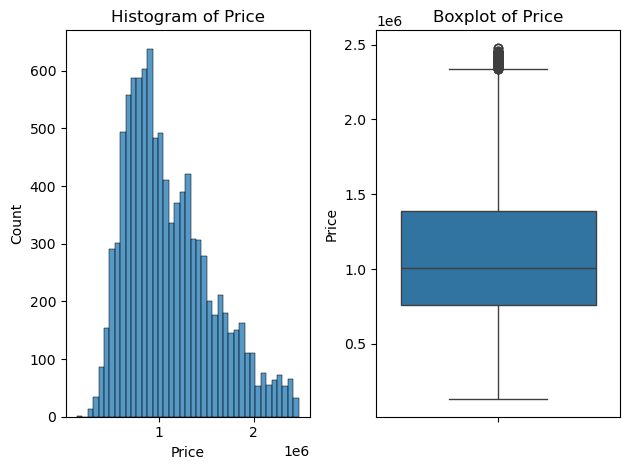

In [64]:
# Examine the distribution of price after dropping outliers using IQR method
visualize_distribution(housing_dropped_iqr, 'Price')

In [65]:
get_skew_kurtosis(housing_dropped_iqr, 'Price')

The skew of Price is: 0.7638560328319632
The kurtosis of Price is: 0.005404221949245169


### IQR Price Distribtuion Analysis

From the graphs above, we can see that the IQR method has removed a substantial number of the outliers. However, there is still a thicker tail on the right hand side of the distribution, which can be seen in the histogram on the left. We can verify these findings using the boxplot on the right which still shows outliers. We choose to keep these outliers because they are not outside of our defined range of 1.5 times the IQR.

We can also see that the skew and kurtosis have improved considerably from original dataset and are better scores than those found in the zscore dataframe. The skew is still slightly positive, but the kurtosis is near 0. We will elect to use this dataset for our model building. 

## Correlation Matrix

We will create a correlation matrix and associated heat map to check the correlation of the different variables in the dataset. We are primarily focusing on each independent features correlation with the dependent variable (Price). However, it is also beneficial to check for strong correlation between the independent features. Strong correlation between independent variables may indicate multicollinearity. Multicollinearity can be an indication that the independent features contain similar information. This can be used to identify potentially redundant variables that can be eliminated. 

In [66]:
# Create a correlation matrix
numeric_cols = housing_dropped_iqr.select_dtypes(include=['float64']).columns
corr_matrix = housing_dropped_iqr.loc[:,numeric_cols].corr()

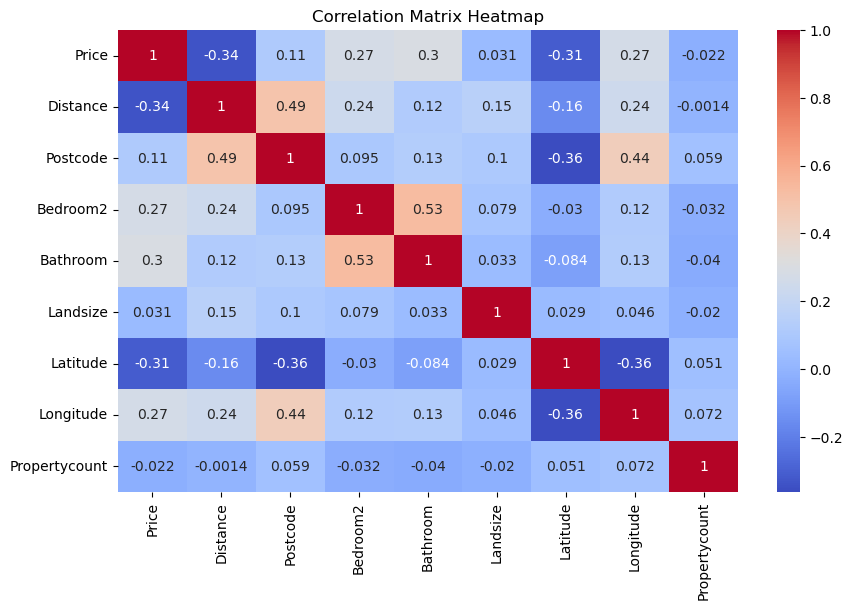

In [67]:
# Create a heatmap of the correlation matrix
plt.figure(figsize=(10,6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix Heatmap')
plt.show()

From the heatmap above, we can see that Distance has a moderately negative correlation with Price with a coefficient of -0.34. In other words, the farther the distance from the City Center, the lower the price becomes. The next strongest correlation we see is latitude, also with a negative correlation of -0.31. This indicates that the higher the latitude, the lower the sale price of the house will be generally. Additionally, there is a moderate positive correlation with the price of a property and the number of bathrooms. Houses that have more bathrooms tend to have higher sale prices.  

In [68]:
housing_dropped_iqr

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Landsize,Latitude,Longitude,Regionname,Propertycount,geometry,IsWaterfront
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,2016-12-03 00:00:00,2.5,3067.0,2.0,1.0,202.0,-37.79960,144.99840,Northern Metropolitan,4019.0,POINT (144.9984 -37.7996),0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,2016-02-04 00:00:00,2.5,3067.0,2.0,1.0,156.0,-37.80790,144.99340,Northern Metropolitan,4019.0,POINT (144.9934 -37.8079),0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,2017-03-04 00:00:00,2.5,3067.0,3.0,2.0,134.0,-37.80930,144.99440,Northern Metropolitan,4019.0,POINT (144.9944 -37.8093),0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,2017-03-04 00:00:00,2.5,3067.0,3.0,2.0,94.0,-37.79690,144.99690,Northern Metropolitan,4019.0,POINT (144.9969 -37.7969),0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,2016-06-04 00:00:00,2.5,3067.0,3.0,1.0,120.0,-37.80720,144.99410,Northern Metropolitan,4019.0,POINT (144.9941 -37.8072),0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13574,Westmeadows,9 Black St,3,h,582000.0,S,Red,2017-08-26 00:00:00,16.5,3049.0,3.0,2.0,256.0,-37.67917,144.89390,Northern Metropolitan,2474.0,POINT (144.8939 -37.67917),0
13575,Wheelers Hill,12 Strada Cr,4,h,1245000.0,S,Barry,2017-08-26 00:00:00,16.7,3150.0,4.0,2.0,652.0,-37.90562,145.16761,South-Eastern Metropolitan,7392.0,POINT (145.16761 -37.90562),0
13576,Williamstown,77 Merrett Dr,3,h,1031000.0,SP,Williams,2017-08-26 00:00:00,6.8,3016.0,3.0,2.0,333.0,-37.85927,144.87904,Western Metropolitan,6380.0,POINT (144.87904 -37.85927),0
13577,Williamstown,83 Power St,3,h,1170000.0,S,Raine,2017-08-26 00:00:00,6.8,3016.0,3.0,2.0,436.0,-37.85274,144.88738,Western Metropolitan,6380.0,POINT (144.88738 -37.85274),0


In [69]:
# Label encode the dataframe
encoded_iqr = housing_dropped_iqr.copy()
encoded_iqr = encode_labels(encoded_iqr)

## Run Models on the IQR Dataset

               Model           RMSE            MAE        R2
0  Linear Regression  301296.443979  225158.913033  0.550277
1      Decision Tree  302648.094235  211754.803775  0.546233
2      Random Forest  202831.118469  144277.653145  0.796190
               Model   Feature1   Feature2      Feature3  Feature4  Feature5  \
0  Linear Regression  Longitude   Latitude  IsWaterfront      Type     Rooms   
1      Decision Tree   Latitude  Longitude      Distance  Landsize     Rooms   
2      Random Forest   Distance   Latitude     Longitude  Landsize  Postcode   

    Importance1    Importance2    Importance3    Importance4    Importance5  
0  1.118927e+06 -942269.210930  350322.409617 -265722.727841  138868.560604  
1  2.371355e-01       0.196220       0.163023       0.109779       0.100645  
2  1.957970e-01       0.175253       0.132419       0.127139       0.109182  


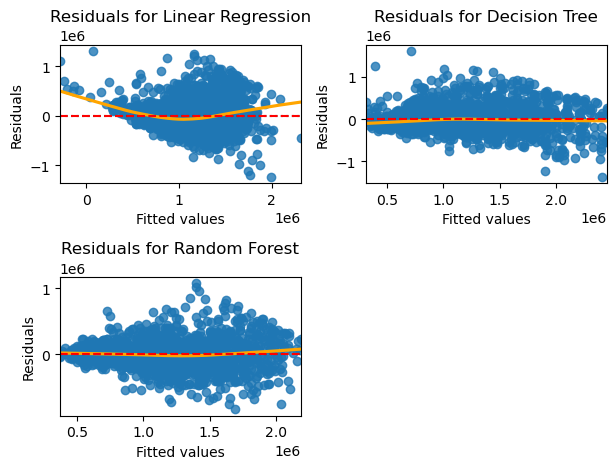

In [70]:
# Run models on the dataset housing_dropped_iqr
output = run_models(encoded_iqr)
scores_df = get_metrics(output)
print(scores_df)
feature_importance = get_feature_importance(output)
print(feature_importance)
plot_residuals(output)

### Residual Plot Analysis
Regarding the residual plots above, we can see several different things. First, the blue dots represent the residuals of the specific data points. These help us to understand where the model’s errors are occurring regarding the predicted sale price (x-axis). Next, we see a red dotted line across the center of the graph. This is known as the zero residual line and all data points would fall on this line in a perfect prediction scenario. Ideally, the points should fall as close as possible to this line. The last aspect of our graph is the solid orange line. This is a line generated by Locally Weighted Scatterplot Smoothing (LOWESS). LOWESS is a non-parametric strategy to fit a smoothed curve to capture the trend between the fitted values and the residuals. This allows us to view the trend of the residuals more easily. 

Now that we have described the graph's components, let us begin our analysis. In the linear regression residual plot, we see that the smoothed curve bows upward at the lower and higher ends of the predicted price. This indicates that the linear regression's performance suffers at the graph's left and right sides. When looking at residual plots, patterns in the errors can indicate problems with the model. Clearly, the linear regression model is not our best predictor.  

In the context of the decision tree residual plot, the smoothed curve performs well, with a small sag in the lower end of the predicted prices. Outside of this, the smoothed curve does not reveal any noticeable patterns. Incidentally, we see some residuals plotted higher towards the left side of the graph but tend to cluster towards the middle and then are plotted lower on the right side of the graph. This indicates that the model may suffer when predicting low and high prices. 

Next, we will analyze the residual plot for the random forest model. This model’s smoothed curve also looks fairly straight with a slight sag in the middle of the graph and then tipping upwards on the right-hand side. Interestingly, this indicates higher residuals near the center of the graph, which is confirmed with the plotted residuals. Furthermore, we also see residuals plotted near the bottom of the graph on the right-hand side, indicating issues with the predictions on the higher prices as well. 

## Selected Model - Random Forest on housing_dropped_iqr

           Model           RMSE            MAE       R2
0  Random Forest  202831.118469  144277.653145  0.79619
           Model  Feature1  Feature2   Feature3  Feature4  Feature5  \
0  Random Forest  Distance  Latitude  Longitude  Landsize  Postcode   

   Importance1  Importance2  Importance3  Importance4  Importance5  
0     0.195797     0.175253     0.132419     0.127139     0.109182  


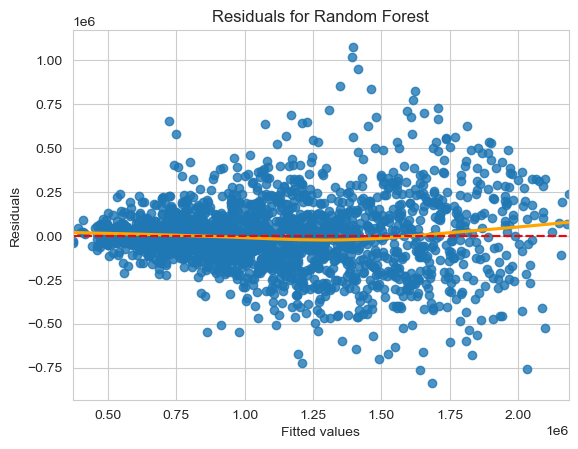

In [109]:
rf_output = run_random_forest(encoded_iqr)
rf_scores_df = get_metrics(rf_output)
print(rf_scores_df)
rf_feature_importance = get_feature_importance(rf_output)
print(rf_feature_importance)
plot_residuals(rf_output)

### Random Forest Residual Plot Analysis

Here we can see a bit bigger image of ther random forest residual plot. 
We can see that the plotted residuals are scattered around zero, which is a good sign indicating that the errors are random and there isn’t a consistent bias in the model’s predictions. 

The orange trend line has a slight bend upward at the left side of the graph and a more pronounced bend at the right side of the graph, indicating that the model may overestimate houses that are very cheap and under-estimate the very expensive houses. 

Overall, this residual plot aligns with our other evaluation metrics and suggests that the model does a decent job of predicting house sale prices, especially houses that are closer to the average sale price

## Graphs Used in Presentation

Expanse Realty is going to need to focus on location, so we needed to make some graphs to illustrate the differences between the different locations. 


<Axes: xlabel='count', ylabel='Regionname'>

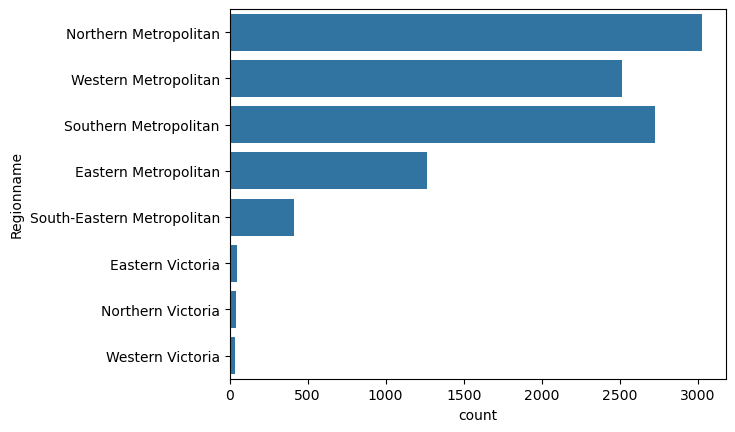

In [106]:
sns.countplot(housing_dropped_iqr['Regionname'])

### Count Plot Analysis

We can see that the Northern Metropolitan Region is the most populated, with the Southern Metropolitan coming in second, and Western in third. 

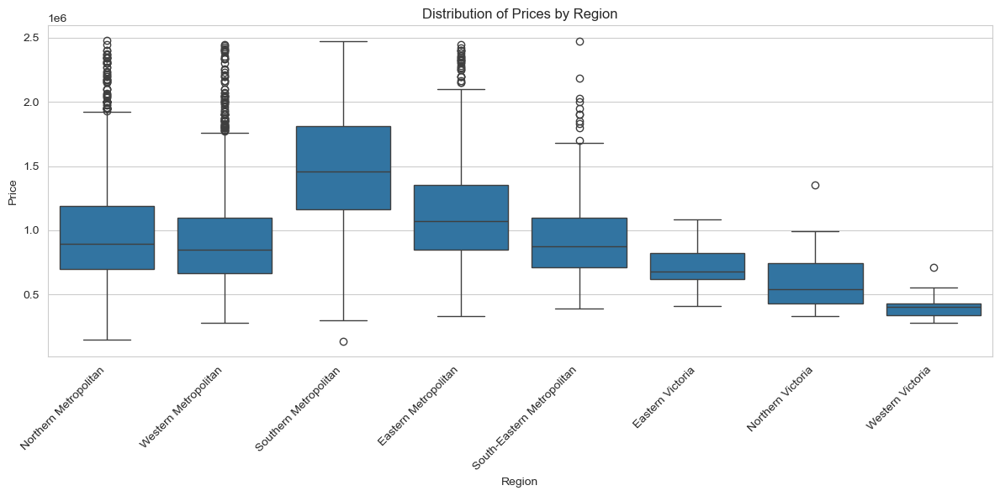

In [107]:
# Create a boxplot of Distribution of Prices by Region
plt.figure(figsize=(12,6))
sns.set_style('whitegrid')
sns.boxplot(data=housing_dropped_iqr, x='Regionname', y='Price')
plt.title('Distribution of Prices by Region')
plt.xlabel('Region')
plt.ylabel('Price')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### Price Distribution by Region

The plot above helps us view the price distribution by region. From this, we can see that the Southern Metropolitan region has the highest average sale price, which is indicated by the horizontal bar in the blue rectangle. 

The next two regions with the highest sales are Eastern Metro and Norther Metro. 


## Conclusion

Overall, we are happy with the performance of our model and look forward to presenting it to Expanse Realty. We belive that it is a good predictor for houses in the Melbourne Metropolitan area and will benefit Expanse Realty in their endeavours. 